### Clustering algorithms (testing & comparing)

* By: [Ismail Ouahbi](https://www.linkedin.com/in/ismail-ouahbi-071145207/)

### Main objective of the analysis 

This case requires to develop a ***customer segmentation to define marketing strategy***. The
sample Dataset summarizes the usage behavior of about ***9000 active credit card holders during the last 6 months.*** The file is at a customer level with 18 behavioral variables.

* [Data set link](https://www.kaggle.com/datasets/arjunbhasin2013/ccdata)

******************************

### 1- Business understanding

* In order to understand well the problem,
let's first understand the maining of each variable in the dataset:


In [36]:
%matplotlib inline
# Load and preview dataset
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
data = pd.read_csv("data/CC GENERAL.csv")

In [4]:
# preview data(first 5rows)
data.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [5]:
# preview data(last 5rows)
data.tail()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.50,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.00,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.25,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.25,6
8949,C19190,372.708075,0.666667,1093.25,1093.25,0.00,127.040008,0.666667,0.666667,0.000000,0.333333,2,23,1200.0,63.165404,88.288956,0.00,6


#### Brief description of the data set 
##### Explain each column(based upon data owner)

***CUST_ID*** : Identification of Credit Card holder (Categorical)

***BALANCE*** : Balance amount left in their account to make purchases

***BALANCE_FREQUENCY*** : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)

***PURCHASES*** : Amount of purchases made from account

***ONEOFF_PURCHASES*** : Maximum purchase amount done in one-go

***INSTALLMENTS_PURCHASES*** : Amount of purchase done in installment

***CASH_ADVANCE*** : Cash in advance given by the user(in $)

***PURCHASES_FREQUENCY*** : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)

***ONEOFFPURCHASESFREQUENCY*** : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)

***PURCHASESINSTALLMENTSFREQUENCY*** : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)

***CASHADVANCEFREQUENCY*** : How frequently the cash in advance being paid

***CASHADVANCETRX*** : Number of Transactions made with "Cash in Advanced"

***PURCHASES_TRX*** : Numbe of purchase transactions made

***CREDIT_LIMIT*** : the maximum amount a cardholder is allowed to spend using a credit card

***PAYMENTS*** : Amount of Payment done by user

***MINIMUM_PAYMENTS*** : Minimum amount of payments made by user

***PRCFULLPAYMENT*** : Percent of full payment paid by user

***TENURE*** : Tenure of credit card service for user(in years)

Now that we've seen a brief explanation of each column, let's explore them using graphics & statistics.

***Business Questions***
* Do `low` amount of purchases mean `low` balance frequency?
* Do `low` purchases frequency mean `high` account balance?
* Do `short-term` tenure distract users from making purchases?
* Do `high amount` of cash in advance given by the user mean `low` balance left in his account? or he has a big amount of money within his account? 
* What `kind` of customers do we have in our company? how many `group of customers` do we have? what `pattern` groups them this way?

******************************

### 2- Exploratory Data Analysis(EDA)

In [37]:
# data shape (number of rows, number of columns)
data.shape

(8950, 18)

In [38]:
print('We have {} rows, {} columns'.format(data.shape[0],data.shape[1]))

We have 8950 rows, 18 columns


In [8]:
# Let's observe data types
data.dtypes

CUST_ID                              object
BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
dtype: object

***Except `CUST_ID` column which has a `categorical type`, all the rest have a `numerical type`***

In [8]:
# descriptive statistics(for numerical columns)
data.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
...,...,...,...,...,...,...,...,...
CREDIT_LIMIT,8949.0,4494.449450,3638.815725,50.000000,1600.000000,3000.000000,6500.000000,30000.00000
PAYMENTS,8950.0,1733.143852,2895.063757,0.000000,383.276166,856.901546,1901.134317,50721.48336
MINIMUM_PAYMENTS,8637.0,864.206542,2372.446607,0.019163,169.123707,312.343947,825.485459,76406.20752
PRC_FULL_PAYMENT,8950.0,0.153715,0.292499,0.000000,0.000000,0.000000,0.142857,1.00000


***We can obsere that:***

* There are some variations within `the scale` of variables

* Some variables have `missing values` (***observe the count column***)

In [9]:
## Let's expand the previous describe method to a more advanced one
from skimpy import skim

skim(data)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 8950   │ │ float64     │ 14    │                                                          │
│ │ Number of columns │ 18     │ │ int32       │ 3     │                                                          │
│ └───────────────────┴────────┘ │ string      │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA    ┃ NA %    ┃ mean   ┃ sd     ┃ p0     ┃ p25    ┃ p75   ┃ p100   ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━━┩  │
│ │ BALANCE                   │     0 │       0 │   1600 │   2100 │      0 │    130 │  2100 │  19000 │   █▁    │  │
│ │ BALANCE_FREQUENCY         │     0 │       0 │   0.88 │   0.24 │      0 │   0.89 │     1 │      1 │    ▁▁█  │  │
│ │ PURCHASES                 │     0 │       0 │   1000 │   2100 │      0 │     40 │  1100 │  49000 │    █    │  │
│ │ ONEOFF_PURCHASES          │     0 │       0 │    590 │   1700 │      0 │      0 │   580 │  41000 │    █    │  │
│ │ INSTALLMENTS_PURCHAS      │     0 │       0 │    410 │    900 │      0 │      0 │   470 │  22000 │    █    │  │
│ │ CASH_ADVANCE              │     0 │       0 │    980 │   2100 │      0 │      0 │  1100 │  47000 │    █    │  │
│ │ PURCHASES_FREQUENCY       │     0 │       0 │   0.49 │    0.4 │      0 │  0.083 │  0.92 │      1 │ █▃▁▂▃█  │  │
│ │ ONEOFF_PURCHASES_FRE      │     0 │       0 │    0.2 │    0.3 │      0 │      0 │   0.3 │      1 │ █▂ ▁▁▁  │  │
│ │ PURCHASES_INSTALLMEN      │     0 │       0 │   0.36 │    0.4 │      0 │      0 │  0.75 │      1 │ █▂▁▁▂▃  │  │
│ │ CASH_ADVANCE_FREQUEN      │     0 │       0 │   0.14 │    0.2 │      0 │      0 │  0.22 │    1.5 │   █▂▁   │  │
│ │ CASH_ADVANCE_TRX          │     0 │       0 │    3.2 │    6.8 │      0 │      0 │     4 │    120 │    █    │  │
│ │ PURCHASES_TRX             │     0 │       0 │     15 │     25 │      0 │      1 │    17 │    360 │    █    │  │
│ │ CREDIT_LIMIT              │     1 │   0.011 │   4500 │   3600 │     50 │   1600 │  6500 │  30000 │   █▃▁   │  │
│ │ PAYMENTS                  │     0 │       0 │   1700 │   2900 │      0 │    380 │  1900 │  51000 │    █    │  │
│ │ MINIMUM_PAYMENTS          │   310 │     3.5 │    860 │   2400 │  0.019 │    170 │   830 │  76000 │    █    │  │
│ │ PRC_FULL_PAYMENT          │     0 │       0 │   0.15 │   0.29 │      0 │      0 │  0.14 │      1 │ █▁   ▁  │  │
│ │ TENURE                    │     0 │       0 │     12 │    1.3 │      6 │     12 │    12 │     12 │      █  │  │
│ └───────────────────────────┴───────┴─────────┴────────┴────────┴────────┴────────┴───────┴────────┴─────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA      ┃ NA %       ┃ words per row                ┃ total words              ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━━╇━━

In [39]:
## Check for unique values within each column
data.duplicated(keep='first').sum()

0

In [40]:
# Check for null values
data.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

***No duplicated values there!***

In [41]:
## The total sum of null values
print("There are",data.isnull().sum().sum(),"null values")

There are 314 null values


#### Missing values imputation

***Before we jump to code, let's list some imputation techniques:***

* Mean/ Median/ Mode Imputation
* K-Nearest Neighbors (KNN) Imputation
* Regression Imputation
* Deep Learning-based Imputation

and so on

***Which technique to use?***

##### For simplicity we'll be using Mean/Median/Mode imputation but, `which statistical measure to use?`

<AxesSubplot:xlabel='CREDIT_LIMIT'>

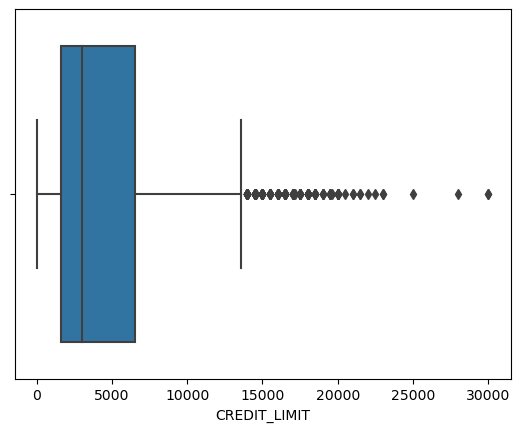

In [17]:
## Let's observe the distribution of features containing missing values
    # for Credit Limit feature

# boxplot
sns.boxplot(x=data.CREDIT_LIMIT)

* As we can notice, there are some outliers and as `the Mean value is affected by outliers`, we may think about Median/Mode imputation 

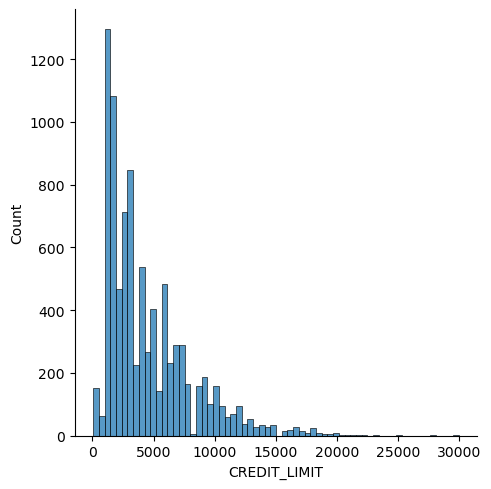

In [23]:
# Distribution plot
sns.displot(x=data.CREDIT_LIMIT)

* The data looks to be `right-skewed` (long tail in the right)

<AxesSubplot:xlabel='MINIMUM_PAYMENTS'>

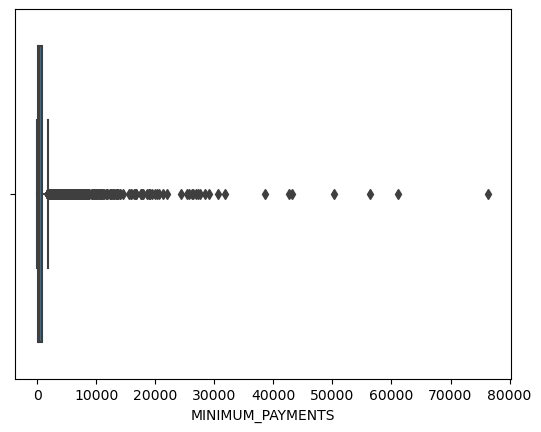

In [28]:
# for MINIMUM_PAYMENTS feature

# boxplot
sns.boxplot(x=data.MINIMUM_PAYMENTS)

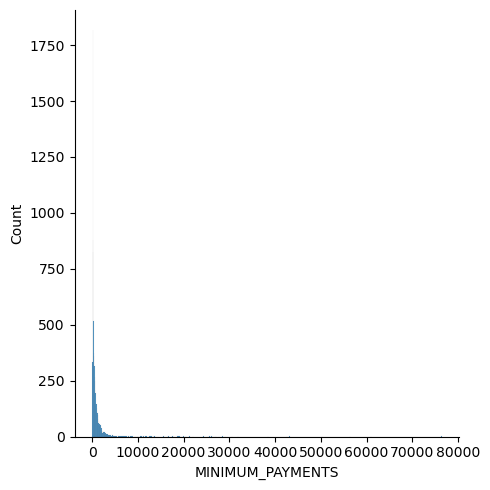

In [29]:
# Distribution plot
sns.displot(x=data.MINIMUM_PAYMENTS)

***Final Decision***

Median imputation is preferred when the `distribution is skewed`, as `the median is less sensitive to outliers` than the mean.

##### Mean/Median/Mode Imputation

In [42]:
# for Credit Limit feature
data['CREDIT_LIMIT'] = data['CREDIT_LIMIT'].fillna(data['CREDIT_LIMIT'].median())

In [43]:
# for MINIMUM_PAYMENTS feature
data['MINIMUM_PAYMENTS'] = data['MINIMUM_PAYMENTS'].fillna(data['MINIMUM_PAYMENTS'].median())

In [44]:
# verification
data.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

******************************

#### Outlier detection

i-***Via visualizations***

In [45]:
# let's first filter non numerical columns
numerical_columns = [i for i in data.columns if data[i].dtype != 'object']

In [46]:
# verify
numerical_columns

['BALANCE',
 'BALANCE_FREQUENCY',
 'PURCHASES',
 'ONEOFF_PURCHASES',
 'INSTALLMENTS_PURCHASES',
 'CASH_ADVANCE',
 'PURCHASES_FREQUENCY',
 'ONEOFF_PURCHASES_FREQUENCY',
 'PURCHASES_INSTALLMENTS_FREQUENCY',
 'CASH_ADVANCE_FREQUENCY',
 'CASH_ADVANCE_TRX',
 'PURCHASES_TRX',
 'CREDIT_LIMIT',
 'PAYMENTS',
 'MINIMUM_PAYMENTS',
 'PRC_FULL_PAYMENT',
 'TENURE']

#### 1- Univariate Outlier Detection

* ***BoxPlots***(we will observe each variable seperatly and look at its distribution) 

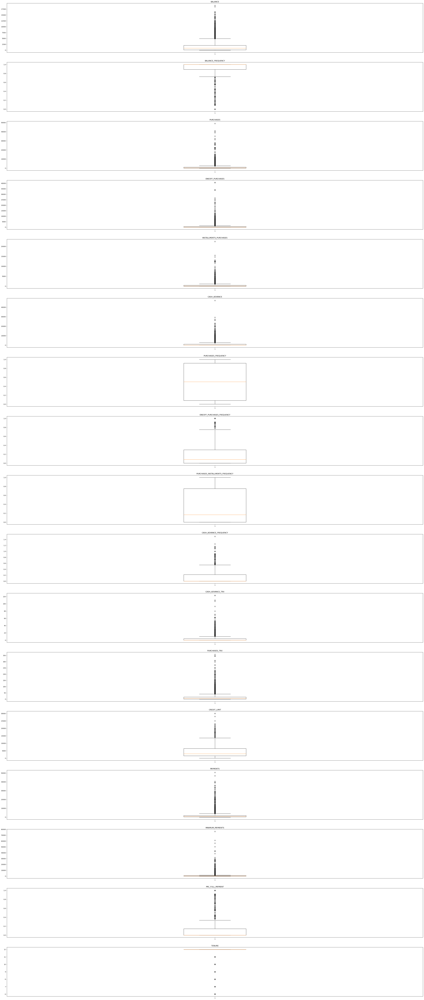

In [47]:
# using the variable axs for multiple Axes
fig, axs = plt.subplots(len(numerical_columns), 1, figsize=(50,120))
for feature,i in zip(numerical_columns,range(len(numerical_columns))):
    axs[i].boxplot(data[[feature]])
    axs[i].title.set_text(f'{feature}')
plt.show()

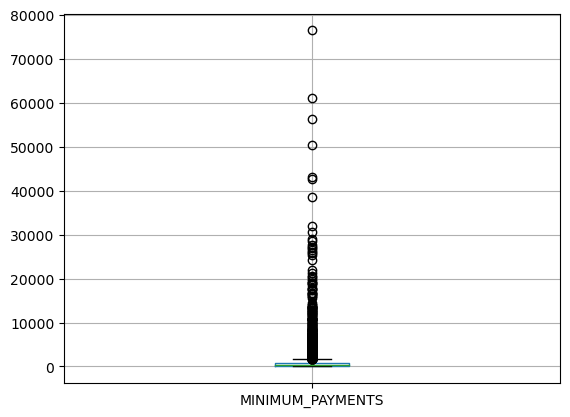

In [48]:
# for credit limit & min payments there was a problem displaying them (I guess due to their scale) so we will plot them here
data[['MINIMUM_PAYMENTS']].boxplot()
plt.show()

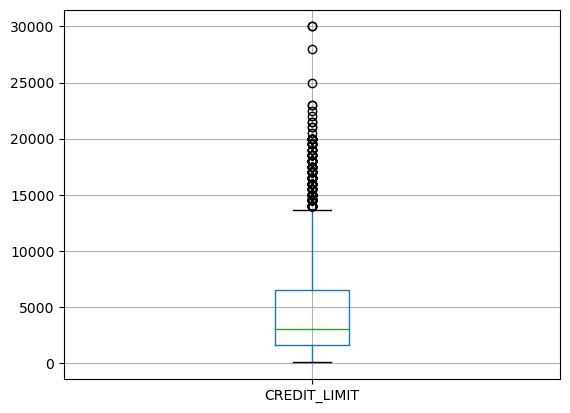

In [49]:
data[['CREDIT_LIMIT']].boxplot()
plt.show()

***Conclusion***: the majority of our variables contain outliers, let's continue proving this using ***statistical methods***

ii-***Via statictics***

In [51]:
## Here I will define a pandas Series that stores the number of outliers detected within the "CREDIT_LIMIT" variable using various methods
outliers_df = pd.Series(dtype=object)

* ***Standard Deviation*** Method

***Example for `CREDIT_LIMIT` variable***

In [52]:
# Find mean, standard deviation and cut off value 
mean = data["CREDIT_LIMIT"].mean()
std = data["CREDIT_LIMIT"].std()

# all variables within the intervall [mean-3std, mean+3std] will be considered as non-outliers
cutoff = 3 * std

# Define lower and upper boundaries
lower, upper = mean-cutoff, mean+cutoff

# Define new dataset by masking upper and lower boundaries
new_CREDIT_LIMIT = data[(data["CREDIT_LIMIT"] > lower) & (data["CREDIT_LIMIT"] < upper)]['CREDIT_LIMIT']

Text(0.5, 1.0, 'without outliers')

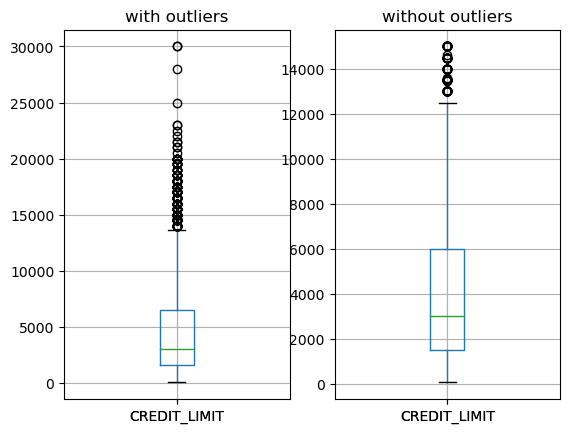

In [53]:
# visualize the difference
# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True)
data[['CREDIT_LIMIT']].boxplot(ax=ax1)
ax1.set_title('with outliers')
new_CREDIT_LIMIT.to_frame().boxplot(ax=ax2)
ax2.set_title('without outliers')

In [54]:
# count the number of outliers
nb_std_outliers = len(data[['CREDIT_LIMIT']]) - len(new_CREDIT_LIMIT)
print("the number of detected outliers using std method is {}".format(nb_std_outliers))

the number of detected outliers using std method is 152


***As you can notice, there is a difference***

In [55]:
# store it inside the pre-defined pandas series
outliers_df['std'] = nb_std_outliers

* ***IQR method***

***Example for `CREDIT_LIMIT` variable***

In [56]:
# Find mean, standard deviation and cut off value 
Q1 = data["CREDIT_LIMIT"].quantile(0.25)
Q3 = data["CREDIT_LIMIT"].quantile(0.75)
IQR= Q3-Q1
# all variables within the intervall [Q1-cutoff*IQR, Q3+cutoff*IQR] will be considered as non-outliers
cutoff = 1.5

# Define lower and upper boundaries
lower, upper = Q1-cutoff*IQR,Q3+cutoff*IQR

# Define new dataset by masking upper and lower boundaries
new_CREDIT_LIMIT_1 = data[(data["CREDIT_LIMIT"] > lower) & (data["CREDIT_LIMIT"] < upper)]['CREDIT_LIMIT']

Text(0.5, 1.0, 'without outliers')

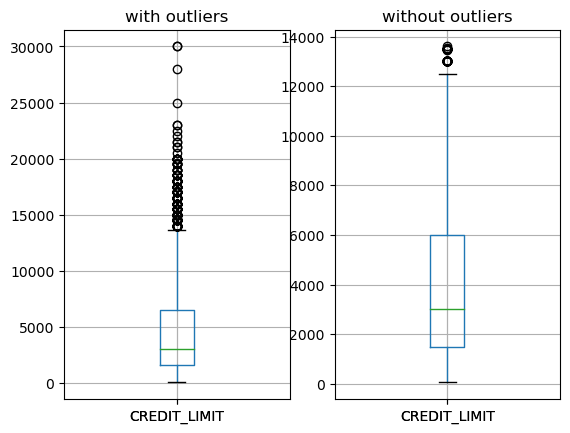

In [57]:
# visualize the difference
# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True)
data[['CREDIT_LIMIT']].boxplot(ax=ax1)
ax1.set_title('with outliers')
new_CREDIT_LIMIT_1.to_frame().boxplot(ax=ax2)
ax2.set_title('without outliers')

In [58]:
# count the number of outliers
nb_IQR_outliers = len(data[['CREDIT_LIMIT']]) - len(new_CREDIT_LIMIT_1)
print("the number of detected outliers using std method is {}".format(nb_IQR_outliers))

the number of detected outliers using std method is 248


***As you can notice, the Inter-Quartile Range Method eleminates more than std method***

In [59]:
# store it inside the pre-defined pandas series
outliers_df['IQR'] = nb_IQR_outliers

#### Multivariate Outlier Detection

* Visualize each 2 different columns via scatter plots

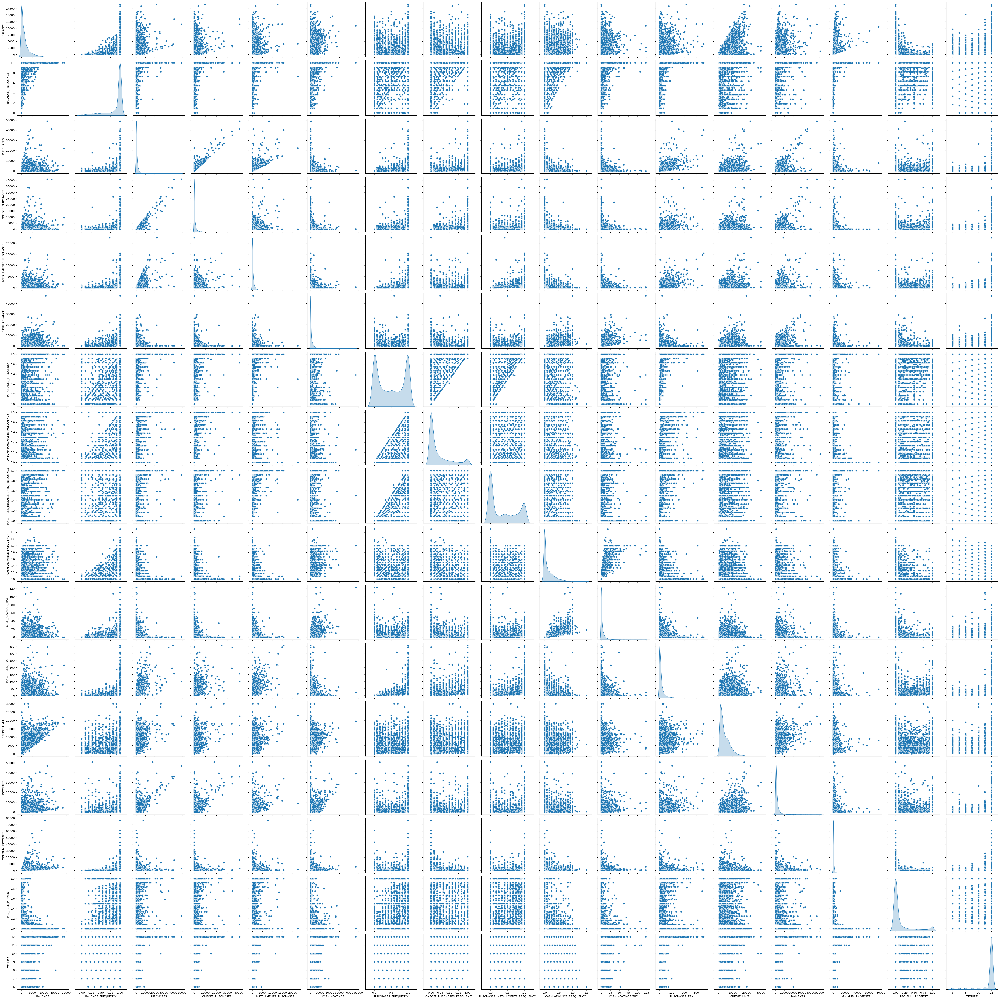

In [28]:
sns.pairplot(data=data, height=3, diag_kind='kde')

* PCA(to reduce the number of dimensions to 3 then visualize them more clearly)

In [61]:
from sklearn.decomposition import PCA
import plotly.express as px

# Dimensionality reduction to 3 dimensions
pca = PCA(n_components=3) 


data_pca = pca.fit_transform(data[numerical_columns])

# 3D scatterplot
fig = px.scatter_3d(x=data_pca[:, 0],
                    y=data_pca[:, 1], 
                    z=data_pca[:, 2])
fig.show()

***Based upon `multivariante outlier detection`, we can notice the existence of some outliers, let's continue through statistical methods***

* ***Isolation Forest Method*** [Random partitioning produces noticeably shorter paths for anomalies. Hence, when a forest of random trees collectively produce shorter path lengths for particular samples, they are highly likely to be anomalies.]

In [65]:
from sklearn.ensemble import IsolationForest

# the dataset
numerical_data = data[numerical_columns]
# Initiate isolation forest
isolation = IsolationForest(n_estimators=100, 
                            contamination='auto', 
                            max_features=numerical_data.shape[1],
                           random_state=42)

# Fit and predict 
isolation.fit(numerical_data)
outliers_predicted = isolation.predict(numerical_data)

# Address outliers in a new column
numerical_data['outlier'] = outliers_predicted

In [66]:
# lets' observe the number of outliers within the CREDIT_LIMIT column & plot it 
numerical_data[numerical_data['outlier']==-1].shape

(811, 18)

***There are `811 outlier` detected using IsolationForest***

In [67]:
# before removing them
numerical_data.shape

(8950, 18)

In [68]:
## remove them
numerical_data_wout_outliers = numerical_data[numerical_data['outlier']==1]

In [69]:
# after removing them
numerical_data_wout_outliers.shape

(8139, 18)

In [70]:
# verify
numerical_data[numerical_data['outlier']==1]['outlier'].value_counts()

1    8139
Name: outlier, dtype: int64

Text(0.5, 1.0, 'without outliers')

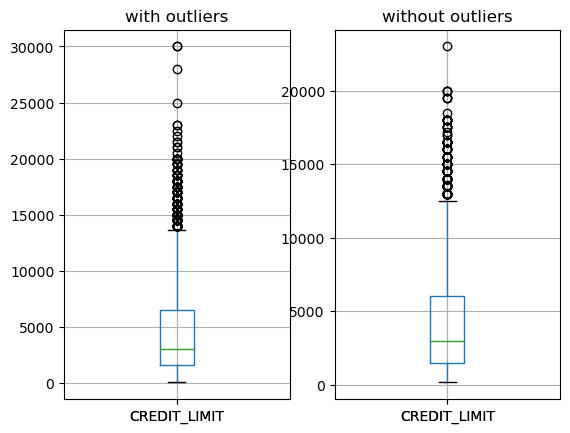

In [71]:
# visualize the difference
# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True)
numerical_data[['CREDIT_LIMIT']].boxplot(ax=ax1)
ax1.set_title('with outliers')
numerical_data_wout_outliers[['CREDIT_LIMIT']].boxplot(ax=ax2)
ax2.set_title('without outliers')

***Isolation forest has detected some outliers based upon multivariante analysis***

In [72]:
# store it inside the pre-defined pandas series
outliers_df['isolation_forest'] = 811

* ***DBSCAN*** for noise(outliers) detection

In [73]:
# take a new copy of numerical data
num_data = data[numerical_columns]

In [74]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
import numpy as np
# Transform data
num_data_copy = np.array(num_data).astype('float')

# Initiate scaler and scale data
scaler = MinMaxScaler()
num_data_copy_scaled = scaler.fit_transform(num_data_copy)

# Initiate DBSCAN (min_samples will be set to n_features & epsilon based upon the above graph)
dbscan = DBSCAN(eps=0.4, min_samples=17)

# Fit DBSCAN on scaled data
dbscan.fit(num_data_copy_scaled)

DBSCAN(eps=0.4, min_samples=17)

In [75]:
# # Address outliers in a new column
num_data['outlier'] = dbscan.labels_

In [76]:
## observe the number of outliers
num_data['outlier'].value_counts()

 0    8772
-1     178
Name: outlier, dtype: int64

***There are `178 outlier` detected using DBSCAN***

In [77]:
## remove them
numerical_data_wout_outliers = num_data[num_data['outlier']==0]

Text(0.5, 1.0, 'without outliers')

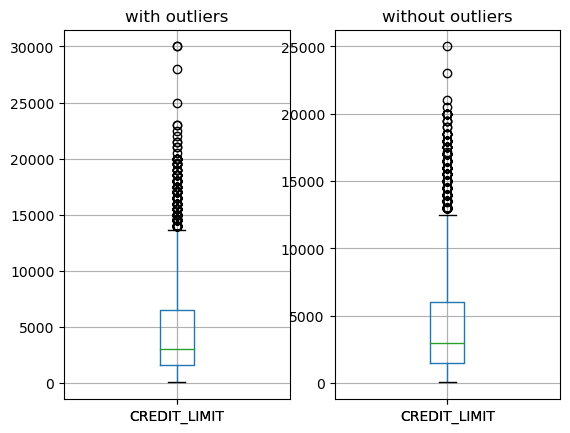

In [78]:
# visualize the difference
# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True)
num_data[['CREDIT_LIMIT']].boxplot(ax=ax1)
ax1.set_title('with outliers')
numerical_data_wout_outliers[['CREDIT_LIMIT']].boxplot(ax=ax2)
ax2.set_title('without outliers')

In [79]:
# store it inside the pre-defined pandas series
outliers_df['DBSCAN'] = 178

*  ***Local Outlier Factor*** (LOF)

In [80]:
from sklearn.neighbors import LocalOutlierFactor

# Initiate LOF
lof = LocalOutlierFactor(n_neighbors=20, contamination='auto')

# Fit and predict on scaled data
outliers_predicted = lof.fit_predict(num_data_copy_scaled)

# Address outliers in a new column
num_data['outlier'] = outliers_predicted

In [81]:
## observe the number of outliers
num_data['outlier'].value_counts()

 1    8318
-1     632
Name: outlier, dtype: int64

***There are `632 outlier` detected using LOF***

In [82]:
## remove them
numerical_data_wout_outliers = num_data[num_data['outlier']==1]

Text(0.5, 1.0, 'without outliers')

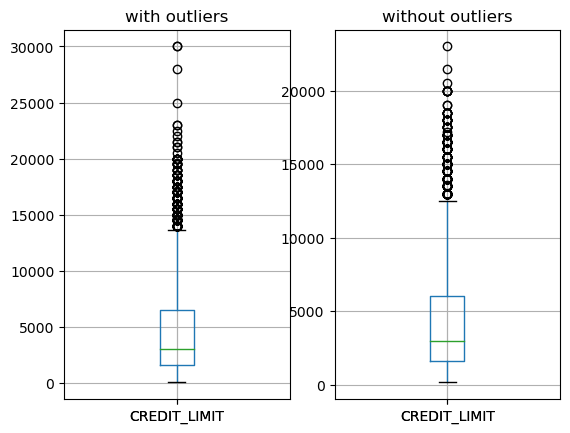

In [83]:
# visualize the difference
# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True)
num_data[['CREDIT_LIMIT']].boxplot(ax=ax1)
ax1.set_title('with outliers')
numerical_data_wout_outliers[['CREDIT_LIMIT']].boxplot(ax=ax2)
ax2.set_title('without outliers')

In [85]:
# store it inside the pre-defined pandas series
outliers_df['LOF'] = 632

#### ***Final Decision?***

In [86]:
# let's visualize the recap of outliers
outliers_df.to_frame().sort_values(by=0)

,0
std,152
DBSCAN,178
IQR,248
LOF,632
isolation_forest,811


***Conclusion***

* While we are working on a real-world case study and each customer's data is crucial for us. 
* We have to choose the method that detects the minimum possible of outliers.
* A multivariante outliers detection method will be better for fast and easy outliers removing/imputation.

***So We'll be using the `DBSCAN method`***

In [90]:
# take a new copy of numerical data
num_data = data[numerical_columns]

In [91]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
import numpy as np
# Transform data
num_data_copy = np.array(num_data).astype('float')

# Initiate scaler and scale data
scaler = MinMaxScaler()
num_data_copy_scaled = scaler.fit_transform(num_data_copy)

# Initiate DBSCAN (min_samples will be set to n_features & epsilon based upon the above graph)
dbscan = DBSCAN(eps=0.4, min_samples=17)

# Fit DBSCAN on scaled data
dbscan.fit(num_data_copy_scaled)

DBSCAN(eps=0.4, min_samples=17)

In [92]:
# # Address outliers in a new column
num_data['outlier'] = dbscan.labels_

In [94]:
num_data['outlier'].value_counts()

 0    8772
-1     178
Name: outlier, dtype: int64

In [98]:
## drop outliers (for fast processing)
num_data = num_data[num_data['outlier']==0]

In [99]:
## verify
num_data['outlier'].value_counts()

0    8772
Name: outlier, dtype: int64

In [100]:
## drop outlier column

num_data.drop('outlier', axis=1, inplace=True)

C:\Users\ISMAIL\AppData\Local\Temp\ipykernel_22244\3701226789.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



***Note that CUST_ID is no longer used, as it's not useful***

******************************

#### Visualize different columns & analyze them

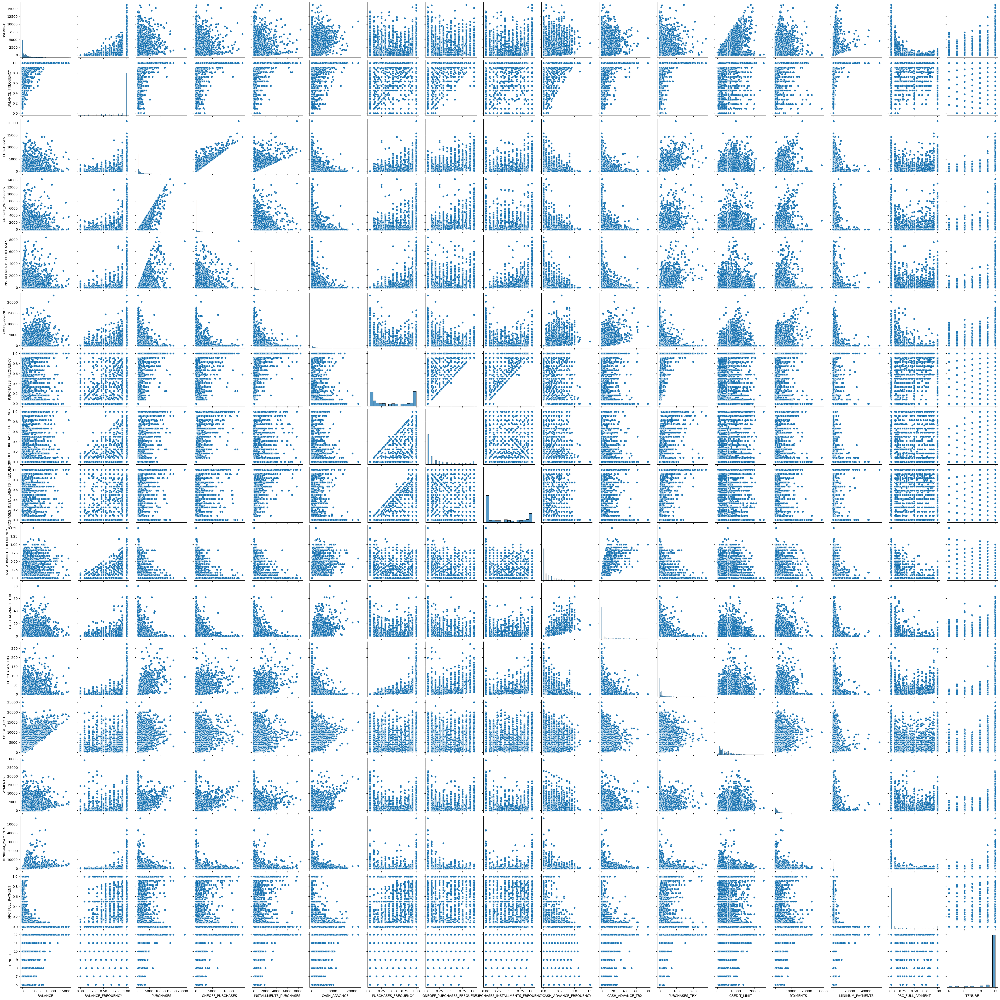

In [119]:
## check for correlation between variables
sns.pairplot(df_)

***It's hard to conclude from the above graph, let's observe these correlations using diffrent techniques***

***Correlation matrix***

<AxesSubplot:>

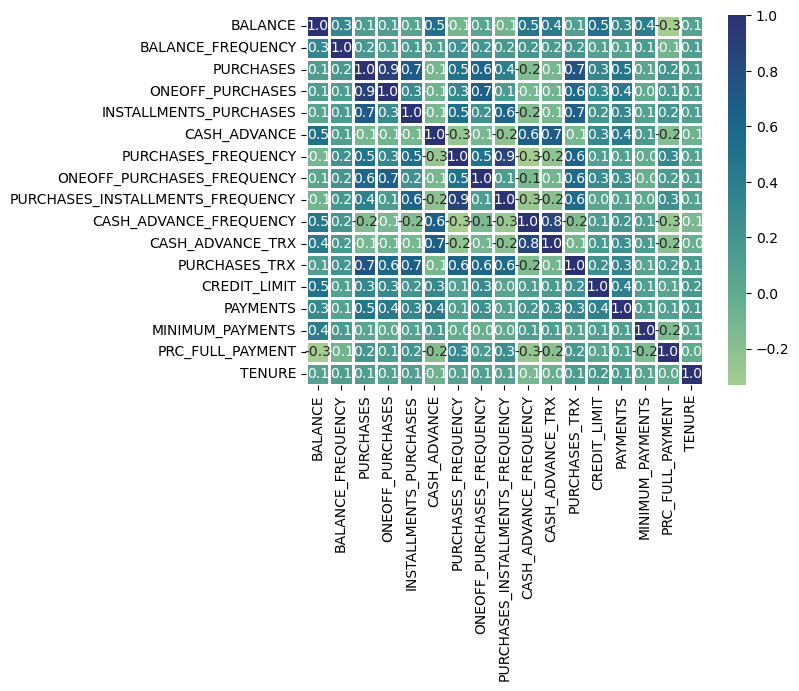

In [14]:
corr_mat_pearson = df_.corr()
sns.heatmap(corr_mat_pearson, annot=True, linewidth=2, fmt=".1f", cmap="crest")

In [15]:
# Strip the diagonal for future examination(to exclude it from .idmax() consideration)
for x in range(corr_mat_pearson.shape[0]):
    corr_mat_pearson.iloc[x,x] = 0.0

In [16]:
## filter only high correlated features
corr_mat_pearson.abs().idxmax()

BALANCE                                                 CASH_ADVANCE
BALANCE_FREQUENCY                                            BALANCE
PURCHASES                                           ONEOFF_PURCHASES
ONEOFF_PURCHASES                                           PURCHASES
INSTALLMENTS_PURCHASES                                     PURCHASES
CASH_ADVANCE                                        CASH_ADVANCE_TRX
PURCHASES_FREQUENCY                 PURCHASES_INSTALLMENTS_FREQUENCY
ONEOFF_PURCHASES_FREQUENCY                          ONEOFF_PURCHASES
PURCHASES_INSTALLMENTS_FREQUENCY                 PURCHASES_FREQUENCY
CASH_ADVANCE_FREQUENCY                              CASH_ADVANCE_TRX
CASH_ADVANCE_TRX                              CASH_ADVANCE_FREQUENCY
PURCHASES_TRX                                              PURCHASES
CREDIT_LIMIT                                                 BALANCE
PAYMENTS                                                   PURCHASES
MINIMUM_PAYMENTS                  

In [17]:
# store this into a variable(after convert it to data frame)
corr_df_pearson =corr_mat_pearson.abs().idxmax().to_frame()

In [18]:
corr_df_pearson

,0
BALANCE,CASH_ADVANCE
BALANCE_FREQUENCY,BALANCE
PURCHASES,ONEOFF_PURCHASES
ONEOFF_PURCHASES,PURCHASES
INSTALLMENTS_PURCHASES,PURCHASES
...,...
CREDIT_LIMIT,BALANCE
PAYMENTS,PURCHASES
MINIMUM_PAYMENTS,BALANCE
PRC_FULL_PAYMENT,BALANCE


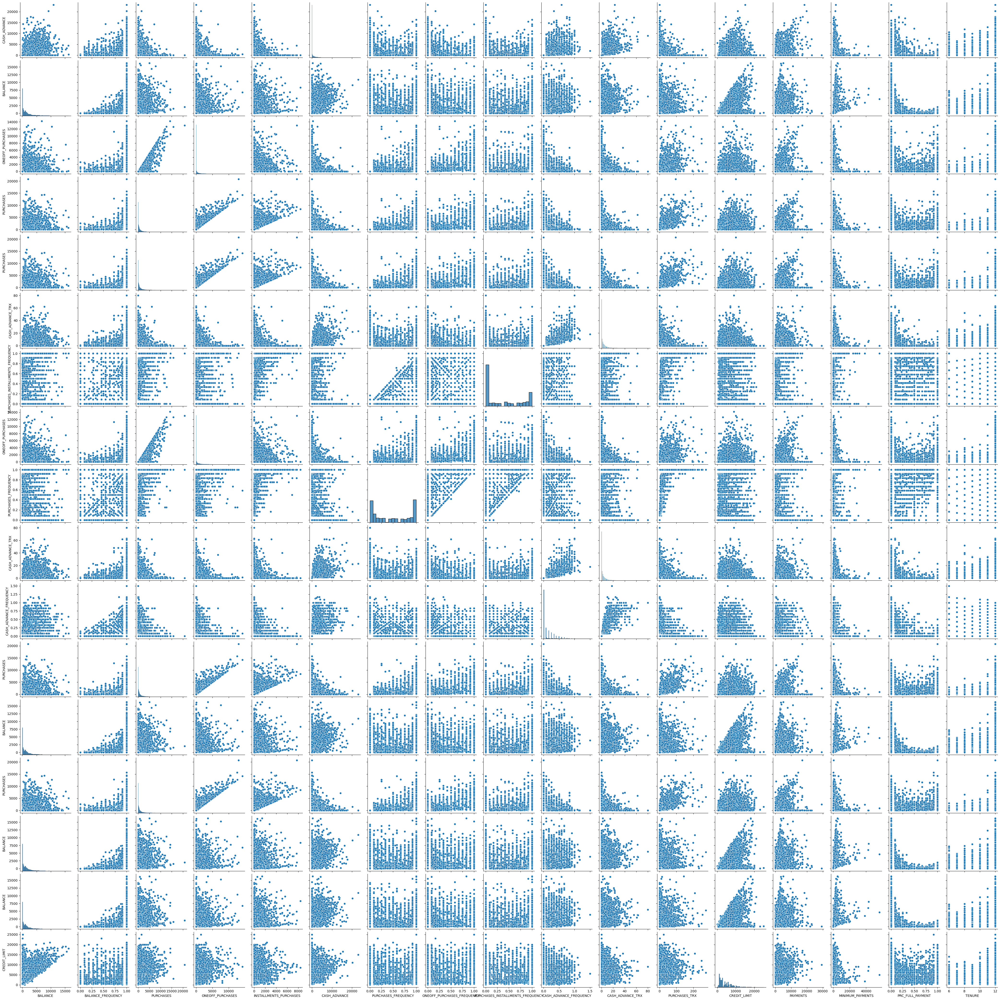

In [20]:
# observe the correlation between selected features (and filter some)
sns.pairplot(
    df_,
    x_vars=corr_df_pearson.index,
    y_vars=corr_df_pearson[0].values,
)

***Interpretation***


***By default pandas.DataFrame.corr uses `pearson method of correlation` which is `a measure of linear correlation between two sets of data` however this is not the case in major datasets***

### Jumping to `spearman rank correlation`

Why `spearman rank correlation`?

***while Pearson's correlation assesses linear relationships, Spearman's correlation assesses monotonic relationships (whether linear or not)***

<AxesSubplot:>

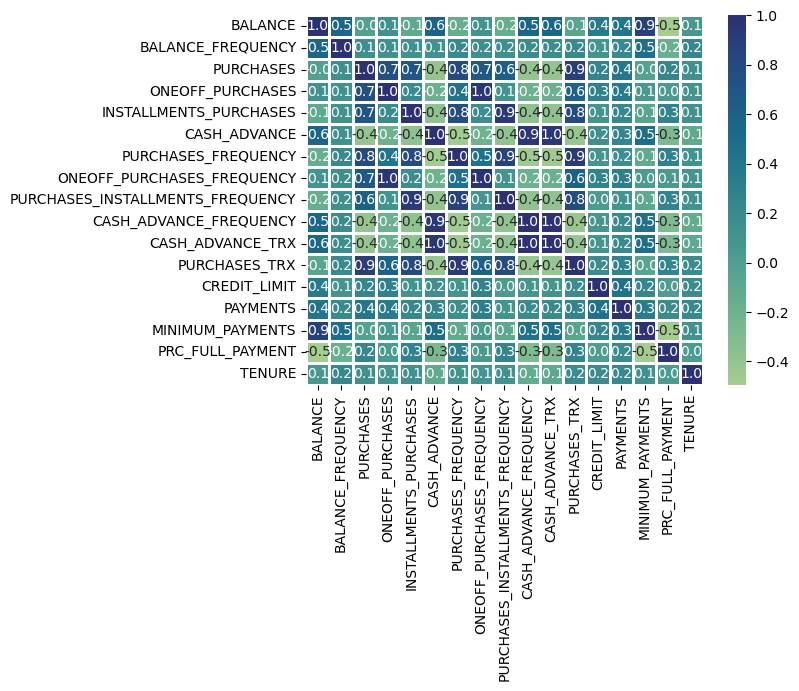

In [21]:
## correlation matrix using spearman rank correlation

corr_mat_spearman = df_.corr(method="spearman")
sns.heatmap(corr_mat_spearman, annot=True, linewidth=2, fmt=".1f", cmap="crest")

In [22]:
# Strip the diagonal for future examination(to exclude it from .idmax() consideration)
for x in range(corr_mat_spearman.shape[0]):
    corr_mat_spearman.iloc[x,x] = 0.0

In [23]:
## filter only high correlated features
corr_mat_spearman.abs().idxmax()

BALANCE                                             MINIMUM_PAYMENTS
BALANCE_FREQUENCY                                            BALANCE
PURCHASES                                              PURCHASES_TRX
ONEOFF_PURCHASES                          ONEOFF_PURCHASES_FREQUENCY
INSTALLMENTS_PURCHASES              PURCHASES_INSTALLMENTS_FREQUENCY
CASH_ADVANCE                                        CASH_ADVANCE_TRX
PURCHASES_FREQUENCY                                    PURCHASES_TRX
ONEOFF_PURCHASES_FREQUENCY                          ONEOFF_PURCHASES
PURCHASES_INSTALLMENTS_FREQUENCY              INSTALLMENTS_PURCHASES
CASH_ADVANCE_FREQUENCY                              CASH_ADVANCE_TRX
CASH_ADVANCE_TRX                              CASH_ADVANCE_FREQUENCY
PURCHASES_TRX                                    PURCHASES_FREQUENCY
CREDIT_LIMIT                                                PAYMENTS
PAYMENTS                                                CREDIT_LIMIT
MINIMUM_PAYMENTS                  

In [24]:
# store this into a variable(after convert it to data frame)
corr_df_spearman =corr_mat_spearman.abs().idxmax().to_frame()

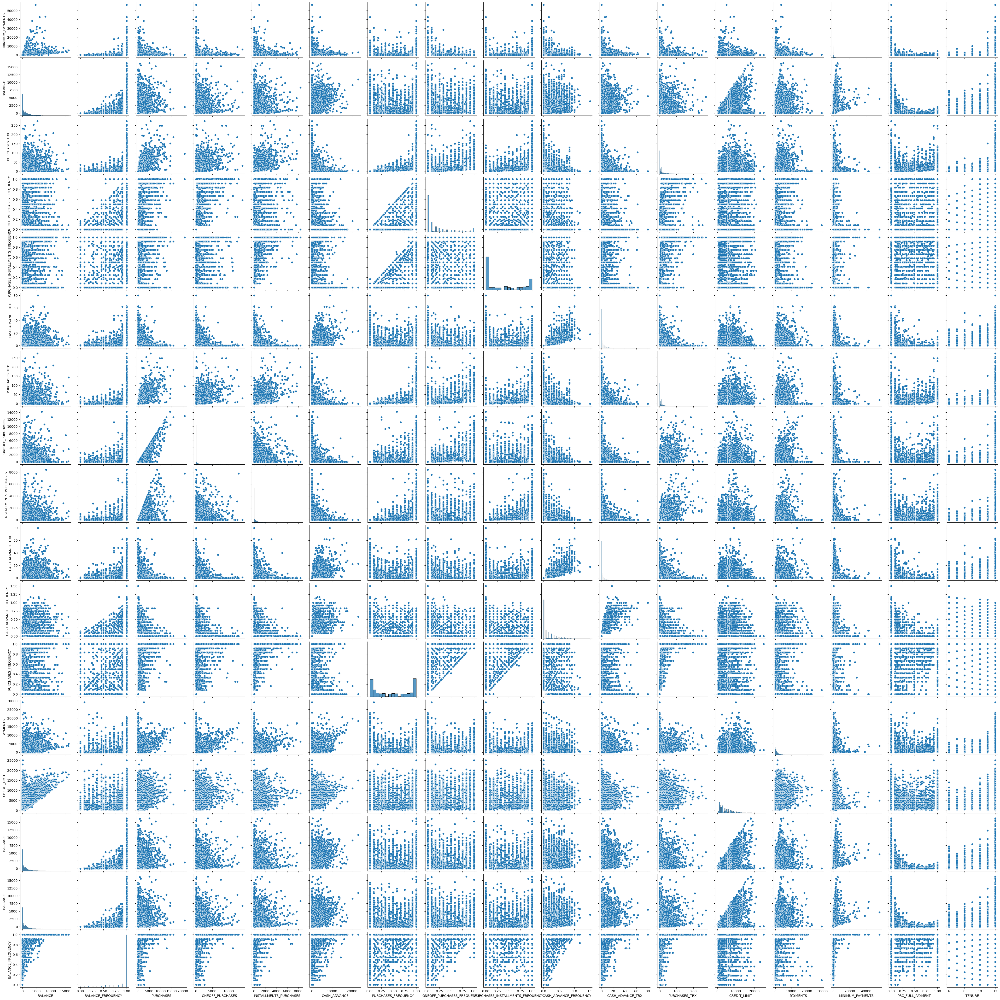

In [26]:
# observe the correlation between selected features (and filter some)
sns.pairplot(
    df_,
    x_vars=corr_df_spearman.index,
    y_vars=corr_df_spearman[0].values,
)

In [152]:
## Let's compare them

print("Using pearson correlation we have {} detected correlated features while we have {} using spearman".format(corr_df_pearson.shape[0],corr_df_spearman.shape[0]))

Using pearson correlation we have 17 detected correlated features while we have 17 using spearman


In [30]:
## Advanced comparison
correlated_to_df = pd.DataFrame(columns=['correlated to (using person)','correlated to (using spearman)'], index=corr_df_pearson.index)
correlated_to_df['correlated to (using person)'] = corr_df_pearson.values
correlated_to_df['correlated to (using spearman)'] = corr_df_spearman.values

In [31]:
correlated_to_df

,correlated to (using person),correlated to (using spearman)
BALANCE,CASH_ADVANCE,MINIMUM_PAYMENTS
BALANCE_FREQUENCY,BALANCE,BALANCE
PURCHASES,ONEOFF_PURCHASES,PURCHASES_TRX
ONEOFF_PURCHASES,PURCHASES,ONEOFF_PURCHASES_FREQUENCY
INSTALLMENTS_PURCHASES,PURCHASES,PURCHASES_INSTALLMENTS_FREQUENCY
...,...,...
CREDIT_LIMIT,BALANCE,PAYMENTS
PAYMENTS,PURCHASES,CREDIT_LIMIT
MINIMUM_PAYMENTS,BALANCE,BALANCE
PRC_FULL_PAYMENT,BALANCE,BALANCE


***Final Decision!***

***Even with the same number of chosen highly correlated features, the detected correlated features vary from pearson coefficient to spearman***

***Examine Skewness(for float columns only)***

In [32]:
## get float columns
float_cols = df_.dtypes[df_.dtypes == float].index

In [33]:
skew_columns = (df_[float_cols]
                .skew()
                .sort_values(ascending=False))

skew_columns = skew_columns.loc[skew_columns > 0.75]
skew_columns

MINIMUM_PAYMENTS              11.351735
ONEOFF_PURCHASES               4.459560
INSTALLMENTS_PURCHASES         3.900067
PURCHASES                      3.662209
PAYMENTS                       3.611953
CASH_ADVANCE                   3.487123
BALANCE                        2.234894
PRC_FULL_PAYMENT               1.986920
CASH_ADVANCE_FREQUENCY         1.798851
ONEOFF_PURCHASES_FREQUENCY     1.588052
CREDIT_LIMIT                   1.394108
dtype: float64

In [36]:
# Perform log transform on skewed columns
for col in skew_columns.index.tolist():
    df_[col] = np.log1p(df_[col])

### Start from here

In [37]:
## save this copy of data (to continue analysis easily)

df_.to_csv("clean_data_CUSTOMER.csv",index=False)

In [3]:
%matplotlib inline
# Load and preview dataset
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [4]:
df_ = pd.read_csv("clean_data_CUSTOMER.csv")

### 3- Modeling part

#### Feature scaling

In [6]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()

## get float columns
float_cols = df_.dtypes[df_.dtypes == float].index

## fit and transform those features
df_[float_cols] = sc.fit_transform(df_[float_cols])

#### K-Means models with cluster values ranging from 1 to 20

In [8]:
from sklearn.cluster import KMeans
# Create and fit a range of models
km_list = list()

#store the number of clusters and the inertia value
for clust in range(1,21):
    km = KMeans(n_clusters=clust, random_state=42)
    km = km.fit(df_[float_cols])
    
    km_list.append(pd.Series({'clusters': clust, 
                              'inertia': km.inertia_,
                              'model': km}))

C:\Users\ISMAIL\anaconda3\lib\site-packages\pandas\core\indexes\base.py:6982: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  return Index(sequences[0], name=names)


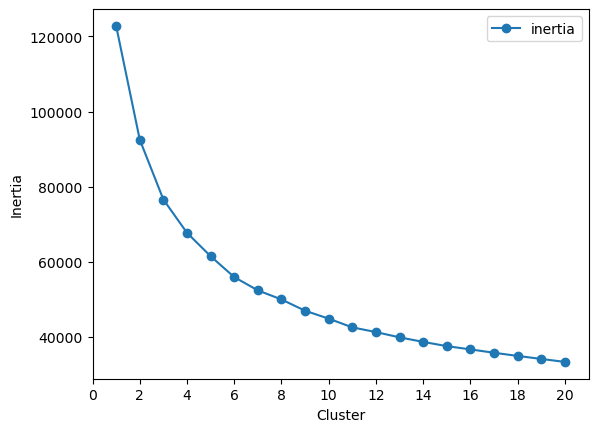

In [9]:
#Plot cluster number vs inertia
plot_data = (pd.concat(km_list, axis=1)
             .T
             [['clusters','inertia']]
             .set_index('clusters'))

ax = plot_data.plot(marker='o',ls='-')
ax.set_xticks(range(0,21,2))
ax.set_xlim(0,21)
ax.set(xlabel='Cluster', ylabel='Inertia');

***Conclusion: We may opt for 4 clusters as the ideal number of clusters!***

----------------------------------------------------------------------------------------------------------------------------

#### Density-Based Spatial Clustering of Applications with Noise (DBSCAN)

In [15]:
## DBSCAN with random initialization of hyperparameters
from sklearn.cluster import DBSCAN
cluster = DBSCAN(eps=5, min_samples=20)
cluster.fit(df_[float_cols])

DBSCAN(eps=5, min_samples=20)

In [21]:
## results
print(f'DBSCAN found {len(set(cluster.labels_) - set([-1]))} clusters and {(cluster.labels_ == -1).sum()} points of noise.')

DBSCAN found 1 clusters and 0 points of noise.


#### Conclusion: we need to tune hyperparameters in order to find the optimal value of clusters

In [22]:
## observe data first 

    # we'll reduce the dimension of our data using PCA to plot it easily in 2D
    
from sklearn.decomposition import PCA
import plotly.express as px

# Dimensionality reduction to 3 dimensions
pca = PCA(n_components=3) 


data_pca = pca.fit_transform(df_[float_cols])

# 3D scatterplot
fig = px.scatter_3d(x=data_pca[:, 0],
                    y=data_pca[:, 1], 
                    z=data_pca[:, 2])
fig.show()

### Notes:

We may misinterpret this viz from the first look

While zooming in we find 2  clusters or maybe 3...!!

#### Hyperparameter tuning

##### we'll be using a method based upon kKearestNeighbors to get distances between two or more neighbors

In [62]:
from sklearn.neighbors import NearestNeighbors
from sklearn import metrics
# k=3
neigh = NearestNeighbors(n_neighbors=3)
nbrs = neigh.fit(df_[float_cols])
distances, indices = nbrs.kneighbors(df_[float_cols])

In [63]:
# next, we sort and plot the results
distances = np.sort(distances, axis=0)
distances = distances[:,1]

In [64]:
# plot distances to find optimal value of eps
fig = px.scatter(
    distances, 
    title='Distance Curve')
fig.update_xaxes(title_text='Distances')
fig.update_yaxes(title_text='Distance threashold (espsilon)')
fig.show()

#### Conclusion

* The optimal value for epsilon will be found at the point of `maximum curvature` in the curve above. It looks like eps = 1.9

In [69]:
# Compute DBSCAN
    # we'll use min_sample = 8 because we don't want a large number of divisions (clusters)
db = DBSCAN(eps=1.9, min_samples=8).fit(df_[float_cols])

labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

Estimated number of clusters: 5
Estimated number of noise points: 128


### Conclusion:

We may opt for `4 clusters` as it's common (almost) between `Kmeans` and `DBSCAN`

note that we can fit other models to this data and maybe do different inferences, it's all about our strategy!

* By: [Ismail Ouahbi](https://www.linkedin.com/in/ismail-ouahbi-071145207/)

* 09/04/2023